# Análise mais elaborada dos dados da BSC (Bright Star Catalogue)

Ao tentar usar a variável distância, inclusive para tentar visualizações 3D

Mas para não perder o foco, vamos tentar o seguinte: 

* Tente desenhar as constelações de Escorpião, Cruzeiro do Sul, Chaleira e da Lhama com os dados. Lembre-se de detalhar a intensidade do brilho e a cor da estrela (temperatura). 
* Ver num plano (perspectiva 2D), a relação de distância (paralaxe) e declínio das estrelas (ou constelações) em relação à Terra.
* Avaliar como plotar algumas estrelas numa perspectiva 3D, ou seja, vamos usar paralaxe, declinação e ascenção reta. Possivelmente vamos usar parsecs como medida.

# Carregar os módulos necessários

In [1]:
import pandas as pd
import numpy as np
import requests
from bs4 import BeautifulSoup
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.graph_objects as go
import math

print(pd)
print(np)
print(requests)
print(BeautifulSoup)
print(plt)
print(sns)
print(go)
print(math)

<module 'pandas' from '/home/chico_linux/.local/lib/python3.10/site-packages/pandas/__init__.py'>
<module 'numpy' from '/home/chico_linux/.local/lib/python3.10/site-packages/numpy/__init__.py'>
<module 'requests' from '/home/chico_linux/.local/lib/python3.10/site-packages/requests/__init__.py'>
<class 'bs4.BeautifulSoup'>
<module 'matplotlib.pyplot' from '/home/chico_linux/.local/lib/python3.10/site-packages/matplotlib/pyplot.py'>
<module 'seaborn' from '/home/chico_linux/.local/lib/python3.10/site-packages/seaborn/__init__.py'>
<module 'plotly.graph_objects' from '/home/chico_linux/.local/lib/python3.10/site-packages/plotly/graph_objects/__init__.py'>
<module 'math' (built-in)>


# Carregar os dados necessários

O HD refere-se ao Henry Draper (HD) Catalogue. Nesse catálogo, não há somente dados da Via Láctea, mas de estrelas mais distantes.

E vamos tentar tirar os dados [desse site](https://in-the-sky.org/data/catalogue.php?cat=HD&const=1&sort=1&view=1) com webscrapping para ter esse catálogo no notebook.

In [2]:
if "hdc_df" in locals() or "hdc_df" in globals():
    display(hdc_df)
else: 
    pages = list(range(1, 93))
    stars = []
    constellation = []
    other_names = []

    for x in pages:

        url = "https://in-the-sky.org/data/catalogue.php?cat=HD&const=1&sort=1&view=1"

        url_target = url + "&page={}".format(x)

        html = requests.get(url_target).content

        soup = BeautifulSoup(html, 'html.parser')

        hdc = soup.tbody

        for i in hdc.find_all('tr'):

            star_name = i.contents[0]

            stars.append(star_name.get_text())

            star_cluster = i.contents[4]

            constellation.append(star_cluster.get_text())

            star_pretty_name = i.contents[7]

            other_names.append(star_pretty_name.get_text())

    hdc_df = pd.DataFrame(data={"star_name": stars, 
                                "star_constellation": constellation, 
                                "star_other_name": other_names})

    hdc_df.to_csv("hd_catalogue.csv", index=False)

    hdc_df

Faça uma base modificada para ajudar no relacionamento desta com as demais. 

In [3]:
hd_poem = hdc_df.copy()

hd_poem = hd_poem.star_other_name.str.split(pat=", ", expand=True)

hd_poem = hd_poem[[0]]

hd_poem = hdc_df.copy().assign(name_poem = hd_poem[0])

hd_poem["hd"] = hd_poem.star_name.str.replace("HD ", "").astype(str)

hd_poem


,star_name,star_constellation,star_other_name,name_poem,hd
0,HD 48915,Canis Major,"Sirius, α-CMa, 9-CMa, HR 2491, HIP 32349",Sirius,48915
1,HD 45348,Carina,"Canopus, α-Car, HR 2326, HIP 30438, TYC 8534-2...",Canopus,45348
2,HD 128620,Centaurus,"Rigil Kentaurus, α-Cen, HR 5459, HIP 71683",Rigil Kentaurus,128620
3,HD 172167,Lyra,"Vega, α-Lyr, 3-Lyr, HR 7001, HIP 91262",Vega,172167
4,HD 34029,Auriga,"Capella, α-Aur, 13-Aur, HR 1708, NSV 1897, HIP...",Capella,34029
...,...,...,...,...,...
9195,HD 86655,Carina,"RR-Car, TYC 8610-2314-1, Gaia EDR3- 5257592479...",RR-Car,86655
9196,HD 154721,Ophiuchus,"R-Oph, TYC 6232-1335-1",R-Oph,154721
9197,HD 44639,Monoceros,"V-Mon, HIP 30326, TYC 4789-1256-1, Gaia EDR3- ...",V-Mon,44639
9198,HD 172171,Ophiuchus,"X Oph, HR 7002, HIP 91389, TYC 1025-1976-1",X Oph,172171


Dados da International Astronomical Union (IAU), onde estão registrados os nomes das estrelas, isto é, há um nome mais poético, ao invés de uma designação mais técnica - conjunto de números com letras, a qual se encaixa em algum catálogo, como o HR (Henry Draper) ou do HIP (Hipparcos). 

In [4]:
url = "http://www.pas.rochester.edu/~emamajek/WGSN/IAU-CSN.txt"

iau = pd.read_table(url, engine="python", 
                    skiprows=12, skipfooter=129, encoding="utf-8", 
                    na_values=["_"]
                    )
iau = iau.reset_index(drop=True).\
    rename(columns={"#Name/ASCII       Name/Diacritics   Designation  ID    ID    Con #    WDS_J       mag  bnd  HIP     HD  RA(J2000)  Dec(J2000) Date       Notes": "coluna"})

# Precisa fazer isso para conseguir separar as colunas de forma eficaz. O único separador possível é espaço, o "\s+"
iau["coluna"] = iau["coluna"].str.replace("HR ", "HR_")
iau["coluna"] = iau["coluna"].str.replace("HD ", "HD_")
iau["coluna"] = iau["coluna"].str.replace("HIP ", "HIP_")
iau["coluna"] = iau["coluna"].str.replace("PSR ", "PSR_")
iau["coluna"] = iau["coluna"].str.replace("BD+14 ", "BD+14_")
iau["coluna"] = iau["coluna"].str.replace("GJ ", "GJ_")

iau = iau.coluna.str.split("\s+", expand=True)
iau = iau.rename(columns={0: "Name/ASCII",
                          1: "Name/Diacritics",
                          2: "Designation",
                          3: "ID_extense",
                          4: "ID",
                          5: "Con",
                          6: "#",
                          7: "WDS_J",
                          8: "mag",
                          9: "bnd",
                          10: "HIP",
                          11: "HD",
                          12: "RA(J2000)",
                          13: "Dec(J2000)",
                          14: "Date"
                          })

iau = iau[iau["Name/ASCII"] != "Mebsuta"] # Valores errados - melhor excluir

iau["RA(J2000)"] = iau["RA(J2000)"].replace("_", np.nan)
iau["RA(J2000)"] = iau["RA(J2000)"].astype(float)
iau["Dec(J2000)"] = iau["Dec(J2000)"].replace("_", np.nan)
iau["Dec(J2000)"] = iau["Dec(J2000)"].astype(float)
iau["Date"] = pd.to_datetime(iau["Date"], errors="coerce")

iau["Designation"] = iau["Designation"].str.replace("_", " ") # Mude para conseguir fazer a conexão

iau = iau[["Name/ASCII", "Name/Diacritics", "Designation", "ID_extense", "ID", "Con", "#", "WDS_J", "mag", "bnd", "HIP", "HD", "RA(J2000)", "Dec(J2000)", "Date"]]

Acrescentar outros campos para ajudar na denominação das estrelas. 

In [5]:
iau["name_conv"] = iau["ID"] + " " + iau["Con"]
iau["HR"] = np.where(iau["Designation"].str.contains("HR "), iau["Designation"].str.replace("HR ", ""), np.nan)

In [6]:
iau

,Name/ASCII,Name/Diacritics,Designation,ID_extense,ID,Con,#,WDS_J,mag,bnd,HIP,HD,RA(J2000),Dec(J2000),Date,name_conv,HR
0,Absolutno,Absolutno,XO-5,_,_,Lyn,_,_,11.95,G,_,_,116.716506,39.094572,2019-12-17,_ Lyn,NaN
1,Acamar,Acamar,HR 897,tet01,θ1,Eri,A,02583-4018,2.88,V,13847,18622,44.565311,-40.304672,2016-07-20,θ1 Eri,897
2,Achernar,Achernar,HR 472,alf,α,Eri,A,_,0.45,V,7588,10144,24.428523,-57.236753,2016-06-30,α Eri,472
3,Achird,Achird,HR 219,eta,η,Cas,A,00491+5749,3.46,V,3821,4614,12.276213,57.815187,2017-09-05,η Cas,219
4,Acrab,Acrab,HR 5984,bet,β,Sco,Aa,16054-1948,2.56,V,78820,144217,241.359300,-19.805453,2016-08-21,β Sco,5984
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
446,Zibal,Zibal,HR 984,zet,ζ,Eri,Aa,03158-0849,4.80,V,15197,20320,48.958436,-8.819731,2016-09-12,ζ Eri,984
447,Zosma,Zosma,HR 4357,del,δ,Leo,_,11141+2031,2.56,V,54872,97603,168.527089,20.523718,2016-07-20,δ Leo,4357
448,Zubenelgenubi,Zubenelgenubi,HR 5531,alf02,α2,Lib,Aa,14509-1603,2.75,V,72622,130841,222.719638,-16.041777,2016-08-21,α2 Lib,5531
449,Zubenelhakrabi,Zubenelhakrabi,HR 5787,gam,γ,Lib,A,15355-1447,3.91,V,76333,138905,233.881578,-14.789536,2017-09-05,γ Lib,5787


Dados retirados do Bright Star Catalog (BSC5P) que estão [neste site](https://heasarc.gsfc.nasa.gov/W3Browse/star-catalog/bsc5p.html) filiado à NASA. Houve um tratamento para colocar em formato .csv

In [7]:
milk = pd.read_csv("bsc5p+.csv")

milk["hd"] = milk["hd"].fillna(0)
milk["hd"] = milk["hd"].astype(int)
milk["hd"] = np.where(milk["hd"] == 0, np.nan, milk["hd"].astype(str))

milk["hr"] = np.where(milk["hr"].isna(), milk["hr"], milk["hr"].astype(int).astype(str))

milk["sao"] = milk["sao"].fillna(0)
milk["sao"] = milk["sao"].astype(int)
milk["sao"] = np.where(milk["sao"] == 0, np.nan, milk["sao"].astype(str))

milk

,name,alt_name,ra,dec,vmag_code,vmag,multiple,class,bv_color,bv_uncert,ub_color,ub_uncert,hd,hr,par_code,parallax,ri_code,sao
0,HR 7228,Sig Oct,317.1925,-88.9564,NaN,5.47,NaN,STAR F0III,0.27,NaN,0.13,NaN,177482,7228,NaN,NaN,NaN,258857
1,HR 8294,NaN,341.3692,-88.8183,NaN,6.57,NaN,STAR F0IV,0.28,NaN,0.13,NaN,206553,8294,NaN,NaN,NaN,258931
2,HR 5491,NaN,232.0796,-88.1331,NaN,6.48,NaN,STAR A0,0.30,NaN,0.10,NaN,129723,5491,NaN,NaN,NaN,258720
3,HR 6721,Chi Oct,283.6954,-87.6058,NaN,5.28,NaN,STAR K3III,1.28,NaN,1.60,NaN,164461,6721,NaN,NaN,NaN,258799
4,HR 6133,NaN,258.9971,-87.5664,NaN,6.57,NaN,STAR G5III,0.91,NaN,0.56,NaN,148451,6133,NaN,NaN,NaN,258754
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9105,HR 8938,NaN,351.7533,87.3075,NaN,5.58,NaN,STAR A7IV,0.23,NaN,0.13,NaN,221525,8938,NaN,NaN,NaN,3916
9106,HR 4686,NaN,183.8346,87.7000,NaN,6.28,NaN,STAR F2V,0.35,NaN,-0.01,NaN,107192,4686,NaN,NaN,NaN,2010
9107,HR 286,NaN,23.4600,89.0156,NaN,6.46,NaN,STAR A3V,0.11,NaN,0.07,NaN,5914,286,NaN,NaN,NaN,209
9108,HR 7394,Lam UMi,259.2367,89.0378,NaN,6.38,W,STAR M1III,1.57,NaN,1.79,NaN,183030,7394,NaN,NaN,NaN,3020


In [8]:
milk.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9110 entries, 0 to 9109
Data columns (total 18 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   name       9110 non-null   object 
 1   alt_name   3157 non-null   object 
 2   ra         9110 non-null   float64
 3   dec        9110 non-null   float64
 4   vmag_code  306 non-null    object 
 5   vmag       9096 non-null   float64
 6   multiple   1577 non-null   object 
 7   class      9110 non-null   object 
 8   bv_color   8786 non-null   float64
 9   bv_uncert  30 non-null     object 
 10  ub_color   7206 non-null   float64
 11  ub_uncert  46 non-null     object 
 12  hd         9096 non-null   object 
 13  hr         9110 non-null   object 
 14  par_code   388 non-null    object 
 15  parallax   3289 non-null   float64
 16  ri_code    303 non-null    object 
 17  sao        9071 non-null   object 
dtypes: float64(6), object(12)
memory usage: 1.3+ MB


Para se ter mente: 

* __RA__: The Right Ascension of the object. It is the astronomical equivalent of __longitude__. When it is cited the J2000, it means [Julian Years](https://en.wikipedia.org/wiki/Epoch_(astronomy)#Julian_years_and_J2000) - the standard for this measure, according to IAU. Unlike longitude, right ascension is usually measured in hours, minutes, and seconds with 24 hours being a full circle (24 hours = 360°). __This means each hour is 15 degrees (1 hour = 15°).__ 

* __Dec__: The Declination of the object - the astronomical equivalent of latitude. Declination is an angular distance of a point north or south of the Celestial Equator, a projection of the Earth’s equator into space. __Declination is measured in degrees from -90° to +90°.__

* __vmag__: Photographic magnitude (in Johnson V) is a measure of the brightness of a star or other astronomical object observed from Earth. An object's apparent magnitude depends on its intrinsic luminosity, its distance from Earth, and any extinction of the object's light caused by interstellar dust along the line of sight to the observer. The scale is reverse logarithmic: the brighter an object is, the lower its magnitude number. In short, it is a measure of __apparent magnitude__.

* __bv_color__: the B-V magnitude and colors on the UBV system.

Tanto RA quanto DEC estão em mensurados em graus, o que facilita a plotagem deles.

Note uma coisa importante: 36% dessa base tem informação de distância

Outra coisa relevante a se ter em mente é que, para ter o ponto de vista de alguém que está inclinando a cabeça para observar as estrelas no céu, é necessário reverter o RA. Como é uma volta, não faz diferença se é horário ou antihorário (inverter), pois o resultado não será afetado, exceto que a gente pode enxergar as constelações no sentido mais familiar. 

Exemplo: o Cruzeiro, se não tem o RA invertido, tem a HR 4700 aparecendo no lado esquerdo, ao invés do direito, ao desenhar a cruz entre as estrelas. 

# Plote todas as estrelas do catálogo

Crie uma variável para índice de cor aplicado às estrelas, tal como é descrito [aqui](https://en.wikipedia.org/wiki/Color_index).

In [9]:
milk["color_index"] = np.where(milk["bv_color"] >= -0.3, "B0V", "O5V")
milk["color_index"] = np.where(milk["bv_color"] >= -0.02, "A0V", milk["color_index"])
milk["color_index"] = np.where(milk["bv_color"] >= 0.3, "F0V", milk["color_index"])
milk["color_index"] = np.where(milk["bv_color"] >= 0.58, "G0V", milk["color_index"])
milk["color_index"] = np.where(milk["bv_color"] >= 0.81, "K0V", milk["color_index"])
milk["color_index"] = np.where(milk["bv_color"] >= 1.4, "M0V", milk["color_index"])

milk.groupby(["color_index"], as_index=False).agg({"bv_color": ["min", "max"]})

color_index bv_color      
                   min   max
0         A0V    -0.02  0.29
1         B0V    -0.28 -0.03
2         F0V     0.30  0.57
3         G0V     0.58  0.80
4         K0V     0.81  1.39
5         M0V     1.40  5.74
6         O5V      NaN   NaN

Plote a BSC num gráfico para ver como fica, e adicone as informações de brilho e cor da estrela no gráfico:

Text(0, 0.5, 'Right Ascention (-90º to 90º)')

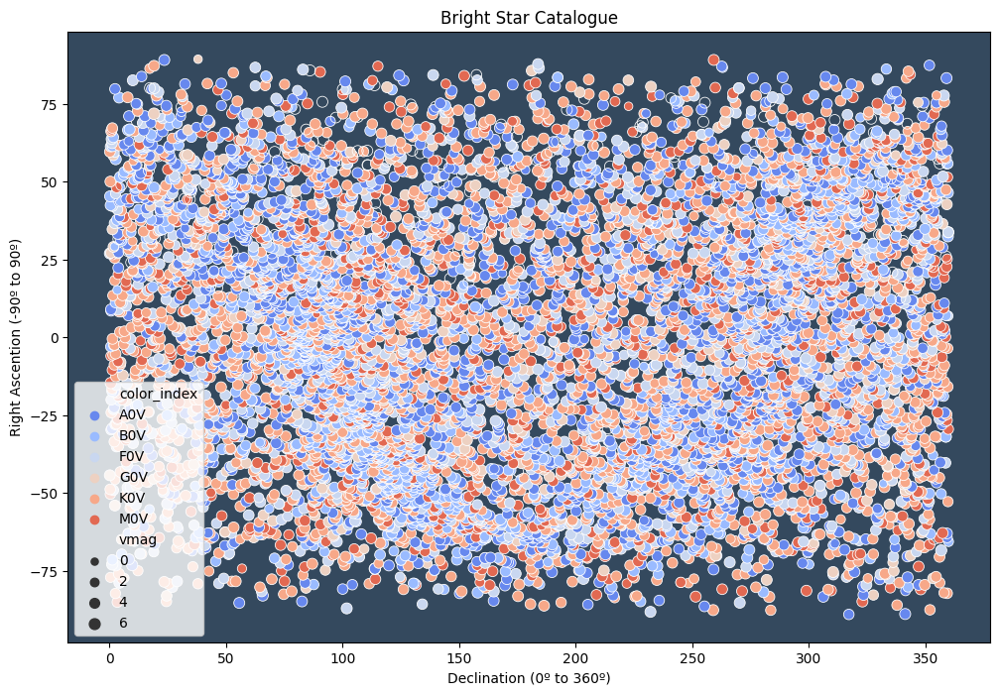

In [10]:
sns.set_style(rc = {"axes.facecolor": "#34495E"})
# sns.set_style("white")

fig, ax = plt.subplots(figsize=(12, 8))

sns.scatterplot(x="ra",
            y="dec", 
            hue="color_index",
            hue_order=["A0V", "B0V", "F0V", "G0V", "K0V", "M0V"],
            size="vmag",
            palette="coolwarm", # Pode usar "Spectral_r" ou "icefire"
            data=milk
            )

ax.legend(facecolor='white', loc="lower left")

ax.set_title("Bright Star Catalogue")
ax.set_xlabel("Declination (0º to 360º)")
ax.set_ylabel("Right Ascention (-90º to 90º)")

Muita informação!!!! Precisa ver um de cada vez. 

Primeiro, vamos ver o catálogo sob o prisma da temperatura. Lembre-se: __quanto mais quente a estrela, exibe-se uma cor azul mais forte, e quanto mais forte a cor vermelha da estrela, esta é mais fria.__

Text(0, 0.5, 'Right Ascention (-90º to 90º)')

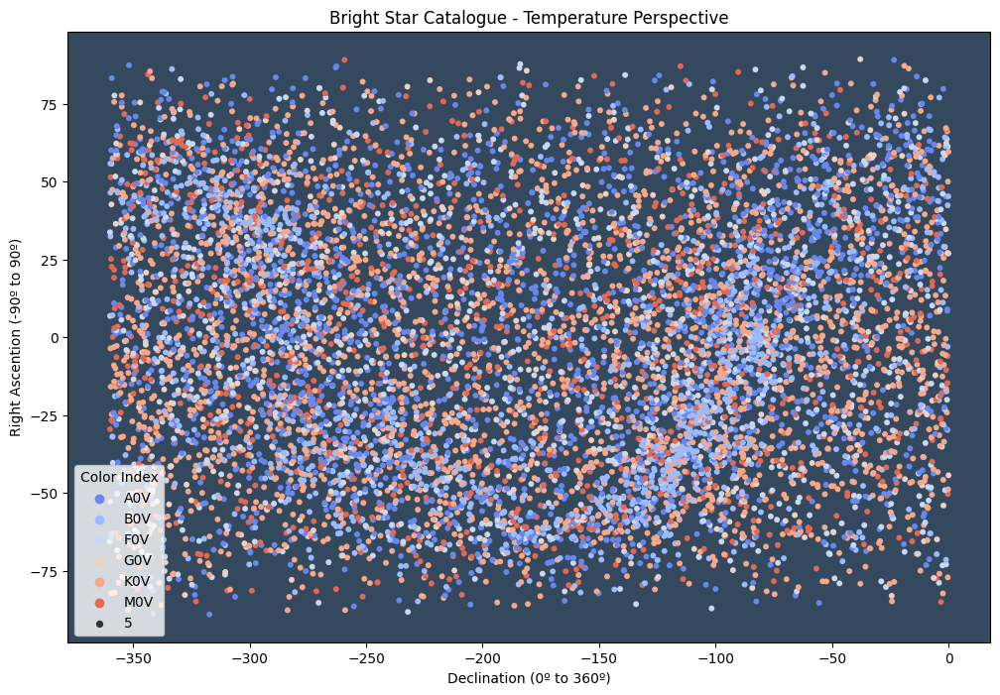

In [11]:
fig, ax = plt.subplots(figsize=(12, 8))

sns.scatterplot(x=-milk.ra, #é necessário inverter
            y=milk.dec, 
            hue=milk.color_index,
            hue_order=["A0V", "B0V", "F0V", "G0V", "K0V", "M0V"], # Para ordernar corretamente a escala de cores conforme o índice
            size=5,
            linewidth=0,
            palette="coolwarm", 
            data=milk
            )

ax.legend(title="Color Index", facecolor='white', loc="lower left")

ax.set_title("Bright Star Catalogue - Temperature Perspective")
ax.set_xlabel("Declination (0º to 360º)")
ax.set_ylabel("Right Ascention (-90º to 90º)")

Note o desenho de curva, que parece um sorriso, é muito similar ao que foi [captado pelo telescópio Tycho](https://svs.gsfc.nasa.gov/3442). 

Agora, faça a visualização, mas denotando o brilho:

Text(0, 0.5, 'Declination (-90º to 90º)')

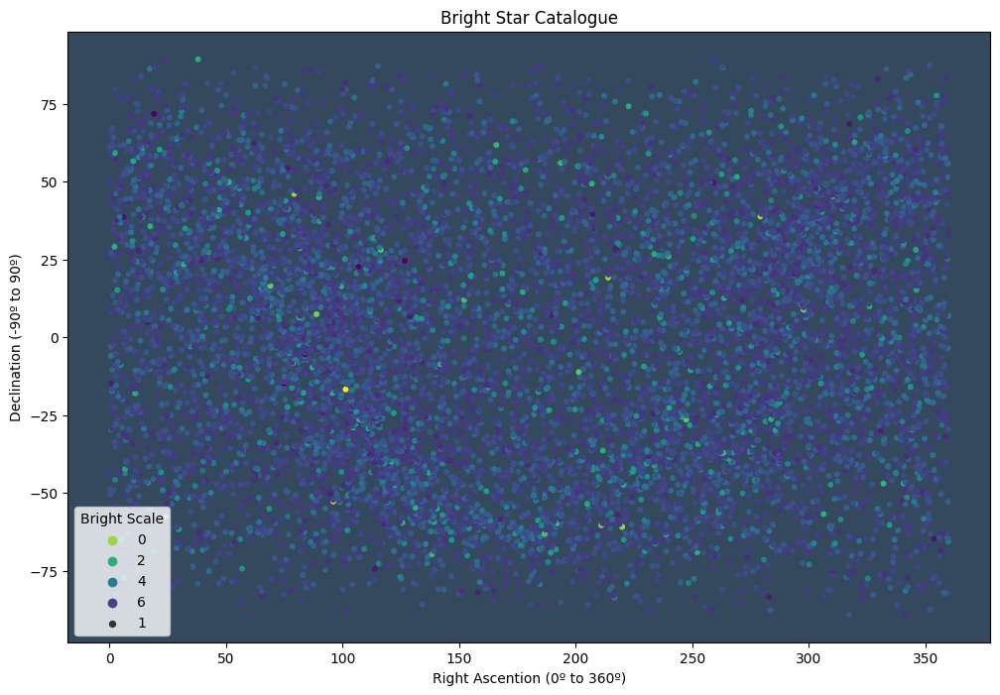

In [12]:
fig, ax = plt.subplots(figsize=(12, 8))

sns.scatterplot(x="ra",
            y="dec", 
            hue="vmag",
            size=1,
            linewidth=0,
            palette="viridis_r", # Ou "light:seagreen"
            data=milk
            )

ax.legend(title="Bright Scale", facecolor='white', loc="lower left")

ax.set_title("Bright Star Catalogue")
ax.set_xlabel("Right Ascention (0º to 360º)")
ax.set_ylabel("Declination (-90º to 90º)")

É similar a essa imagem, mas a visualização está invertida. Não sei qual está correta ou não

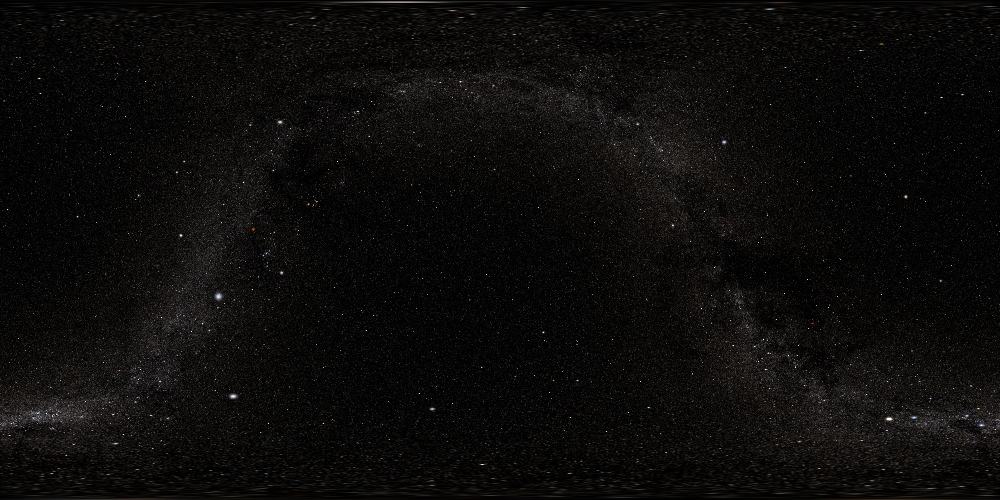

# Plote a visualização do Cruzeiro do Sul (Southern Cross)

Invista em detalhes sobre brilho e cor das estrelas. 

Vamos plotar as estrelas que sabe-se, de fato, que são da Crux constelação: 

* A HR 4731 e HR 4730 são Alpha Crux
* A HR 4763 é Gama Crux
* A HR 4853 é Beta Crux
* A HR 4656 é Delta Crux
* Por fim, a HR 4700 é a Epsilon Crux, aquela que não fica nas pontas da constelação

In [13]:
cruz = milk.copy()

cruz["Crux"] = np.where(cruz.name.isin(["HR 4731", "HR 4730", "HR 4763", "HR 4853", "HR 4656", "HR 4700"]), True, False)

In [14]:
cruz = cruz[cruz.Crux == True]

cruz

,name,alt_name,ra,dec,vmag_code,vmag,multiple,class,bv_color,bv_uncert,ub_color,ub_uncert,hd,hr,par_code,parallax,ri_code,sao,color_index,Crux
537,HR 4731,Alp2Cru,186.6521,-63.0994,NaN,1.73,W,STAR B1V,-0.26,NaN,-0.95,NaN,108249,4731,D,0.008,NaN,NaN,B0V,True
538,HR 4730,Alp1Cru,186.6496,-63.0992,NaN,1.33,W,STAR B0IV,-0.24,NaN,-1.03,NaN,108248,4730,D,0.008,NaN,251904,B0V,True
680,HR 4700,Eps Cru,185.3400,-60.4011,NaN,3.59,NaN,STAR K3III,1.42,NaN,1.63,NaN,107446,4700,NaN,0.026,NaN,251862,M0V,True
725,HR 4853,Bet Cru,191.9300,-59.6886,NaN,1.25,W,STAR B0III,-0.23,NaN,-1.00,NaN,111123,4853,NaN,NaN,NaN,240259,B0V,True
779,HR 4656,Del Cru,183.7863,-58.7489,NaN,2.80,NaN,STAR B2IV,-0.23,NaN,-0.91,NaN,106490,4656,NaN,0.003,NaN,239791,B0V,True
862,HR 4763,Gam Cru,187.7912,-57.1133,NaN,1.63,W,STAR M3III,1.59,NaN,1.78,NaN,108903,4763,NaN,NaN,NaN,240019,M0V,True


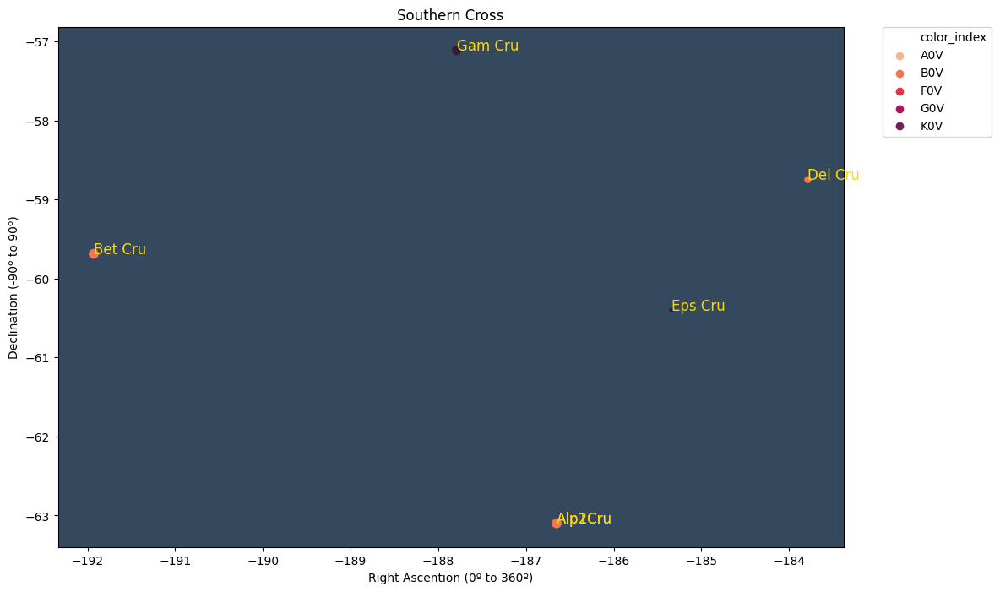

In [15]:
fig, ax = plt.subplots(figsize=(12, 8))

fig = sns.scatterplot(x=-cruz.ra, # Tem que inverter para conseguir ver tal como nós vemos no hemisfério sul. 
            y=cruz.dec, 
            hue=cruz.color_index,
            hue_order=["A0V", "B0V", "F0V", "G0V", "K0V", "M0V"],
            size=-cruz.vmag, 
            linewidth=0,
            palette="rocket_r", #Essa paleta é invertida com o sufixo 'r'
            data=cruz
            )

for x, y, name in zip(-cruz.ra, cruz.dec, cruz.alt_name):
    ax.text(x, y, name, color="gold", fontsize=12)

ax.set_title("Southern Cross")
ax.set_xlabel("Right Ascention (0º to 360º)")
ax.set_ylabel("Declination (-90º to 90º)")

h,l = fig.get_legend_handles_labels()
plt.legend(h[0:6],l[0:6],bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0., facecolor="white")

## Plote a "Chaleira"

In [16]:
tetera = milk.copy()

tetera = tetera[tetera.name.isin(["HR 6859", "HR 6879", "HR 7194", "HR 7039", "HR 6913", "HR 6746", "HR 7121", "HR 7234"])]

tetera = tetera.merge(hd_poem[["hd", "name_poem", "star_constellation"]], 
                                how="left", 
                                on="hd")

tetera

,name,alt_name,ra,dec,vmag_code,vmag,multiple,class,bv_color,bv_uncert,...,ub_uncert,hd,hr,par_code,parallax,ri_code,sao,color_index,name_poem,star_constellation
0,HR 6879,20Eps Sgr,276.0429,-34.3847,NaN,1.85,W,STAR B9III,-0.03,NaN,...,NaN,169022,6879,NaN,0.023,NaN,210091,B0V,Kaus Australis,Sagittarius
1,HR 6746,10Gam2Sgr,271.4521,-30.4242,NaN,2.99,NaN,STAR K0III,1.00,NaN,...,NaN,165135,6746,NaN,0.025,NaN,209696,K0V,Alnasl,Sagittarius
2,HR 7194,38Zet Sgr,285.6529,-29.8803,NaN,2.60,NaN,STAR A2III,0.08,NaN,...,NaN,176687,7194,NaN,0.025,NaN,187600,A0V,Ascella,Sagittarius
3,HR 7194,38Zet Sgr,285.6529,-29.8803,NaN,2.60,NaN,STAR A2III,0.08,NaN,...,NaN,176687,7194,NaN,0.025,NaN,187600,A0V,Ascella,Sagittarius
4,HR 6859,19Del Sgr,275.2487,-29.8281,NaN,2.70,NaN,STAR K3III,1.38,NaN,...,NaN,168454,6859,NaN,0.047,NaN,186681,K0V,Kaus Media,Sagittarius
5,HR 7234,40Tau Sgr,286.7350,-27.6706,NaN,3.32,NaN,STAR K1III,1.19,NaN,...,NaN,177716,7234,NaN,0.044,NaN,187683,K0V,τ-Sgr,Sagittarius
6,HR 7039,27Phi Sgr,281.4142,-26.9908,NaN,3.17,D,STAR B8III,-0.11,NaN,...,NaN,173300,7039,NaN,NaN,NaN,187239,B0V,φ-Sgr,Sagittarius
7,HR 7121,34Sig Sgr,283.8163,-26.2967,NaN,2.02,W,STAR B2V,-0.22,NaN,...,NaN,175191,7121,NaN,NaN,NaN,187448,B0V,Nunki,Sagittarius
8,HR 6913,22Lam Sgr,276.9925,-25.4217,NaN,2.81,NaN,STAR K1III,1.04,NaN,...,NaN,169916,6913,NaN,0.053,NaN,186841,K0V,Kaus Borealis,Sagittarius


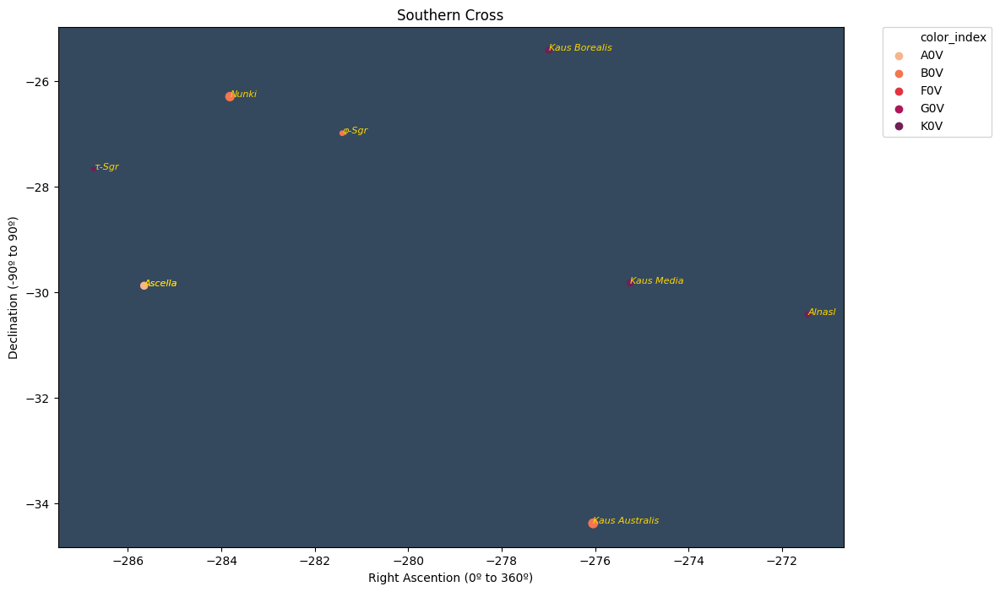

In [17]:
fig, ax = plt.subplots(figsize=(12, 8))

fig = sns.scatterplot(x=-tetera.ra,
            y=tetera.dec, 
            hue=tetera.color_index,
            hue_order=["A0V", "B0V", "F0V", "G0V", "K0V", "M0V"],
            size=-tetera.vmag, # Maior a magnitude, menor o brilho - menor o tamanho da estrela (nesta visualização)
            linewidth=0,
            palette="rocket_r",
            data=tetera
            )

for x, y, name in zip(-tetera.ra, tetera.dec, tetera.name_poem):
    ax.text(x, y, name, color="gold", fontsize=8, style="oblique")

ax.set_title("Southern Cross")
ax.set_xlabel("Right Ascention (0º to 360º)")
ax.set_ylabel("Declination (-90º to 90º)")

h,l = fig.get_legend_handles_labels()
plt.legend(h[0:6],l[0:6],bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0., facecolor="white")

## Busque a constelação da Lhama, a Yakana

Yakana es una gran llama que camina en medio de la Vía Láctea. Todavía podemos verla en el cielo, porque es una constelación y está junto a otras tres que rodean a la Chakana (la cruz del sur).

Yakana es una de estas constelaciones oscuras de los Likan Antai, donde “su ‘ojo’ sería nuestra vecina estelar Alfa Centauri”.

In [18]:
llama = milk[(milk.ra.between(170, 330)) & (milk.dec.between(-80,-40))].copy()

llama = llama.merge(hd_poem[["hd", "name_poem", "star_constellation"]], 
                                how="left", 
                                on="hd")

llama["Crux_Centauri"] = np.where(llama.name.isin(["HR 4731", "HR 4730", "HR 4763", "HR 4853", "HR 4656", "HR 4700", "HR 5459", "HR 5460"]), True, False)

Text(0, 0.5, 'Declination (-90º to 90º)')

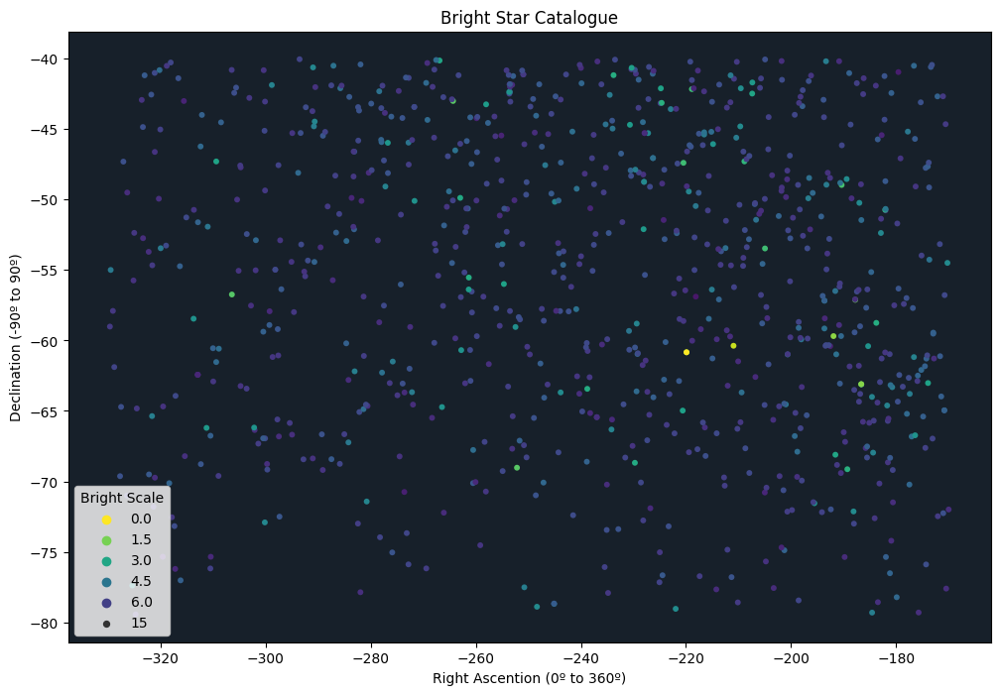

In [19]:
sns.set_style(rc = {"axes.facecolor": "#17202A"})

fig, ax = plt.subplots(figsize=(12, 8))

sns.scatterplot(x=-1*llama.ra,
            y=llama.dec, 
            hue=llama.vmag,
            size=15,
            alpha=1.0,
            linewidth=0,
            palette="viridis_r", 
            data=llama
            )

ax.legend(title="Bright Scale", facecolor='white', loc="lower left")

ax.set_title("Bright Star Catalogue")
ax.set_xlabel("Right Ascention (0º to 360º)")
ax.set_ylabel("Declination (-90º to 90º)")

## Veja as estrelas num plano 2D 

Mas antes de sair fazendo isso, tente entender a variável distância, medida em arcsecs, ao exibir quai são as estrelas mais próximas da Terra, conforme a variável paralaxe. 

In [20]:
far_close = milk[(milk.parallax.notna()) & (milk.par_code.isna())].copy() # Só o trigonométrico
far_close = far_close[far_close.parallax > 0]

far_close = far_close.merge(hd_poem[["hd", "name_poem", "star_constellation"]], 
                                    how="left", 
                                    on="hd")

far_close = far_close[far_close.name_poem.notna()]

far_close["parallax"] = np.where(far_close["parallax"] < 0, 0, far_close["parallax"]) # Há valores negativos na faixa zero - transforma zero de uma vez

far_close = far_close.assign(parallax_parsec = 1/far_close.parallax)
far_close = far_close.sort_values(["parallax_parsec"], ascending=True).head(40)

[]

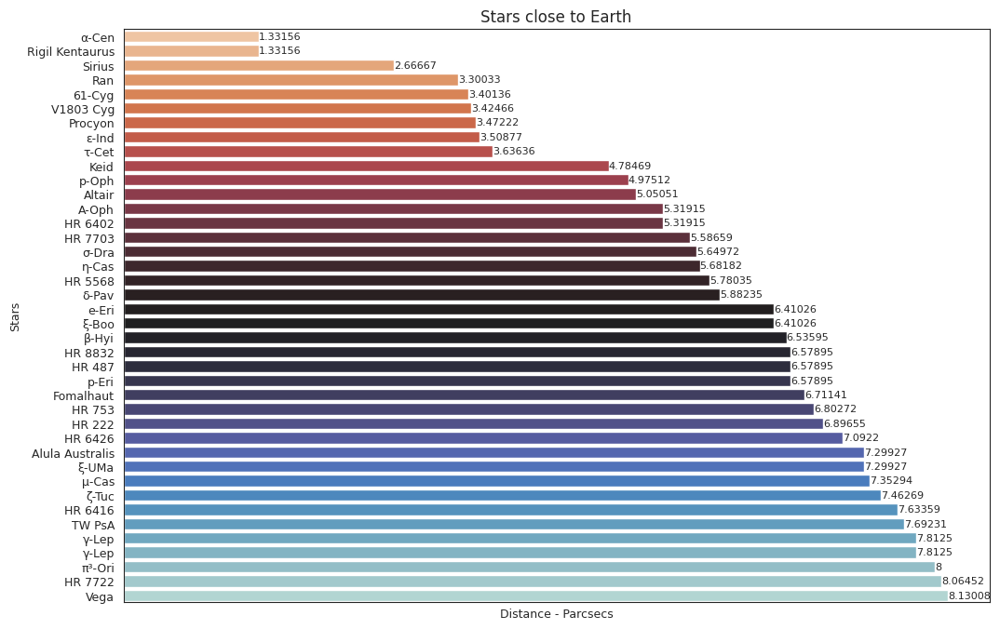

In [24]:
sns.set_style("white")

fig, ax = plt.subplots(figsize=(12, 8))

sns.barplot(x=far_close.parallax_parsec,
            y=far_close.name_poem, 
            order=far_close.sort_values('parallax_parsec', ascending=True).name_poem,
            # width=5.0,
            # hue=far_close.color_index,
            # hue_order=["A0V", "B0V", "F0V", "G0V", "K0V", "M0V"],
            palette="icefire_r",
            data=far_close
            )

plt.xlabel("Distance - Parcsecs", size=9)
plt.ylabel("Stars", size=9)
plt.yticks(fontsize=9)
ax.set_title("Stars close to Earth")
ax.bar_label(ax.containers[0], size= 8)
ax.set_xticks([])

Há imprecisões nos dados de distância (muitos com 1000 parsecs - algo estranho), mas as estrelas mais próximas da Terra são estas mesmas (Sirius, Alpha Centauris)

Veja num plano que tenha declinância e distância. A ideia é saber o que está perto da Terra. 

In [22]:
milk_distance = milk[(milk.parallax.notna()) & (milk.par_code.isna())].copy() # Só o trigonométrico
milk_distance = milk_distance[milk_distance.parallax > 0]

milk_distance = milk_distance.merge(hd_poem[["hd", "name_poem", "star_constellation"]], 
                                    how="left", 
                                    on="hd")

milk_distance["parallax"] = np.where(milk_distance["parallax"] < 0, 0, milk_distance["parallax"]) # Há valores negativos na faixa zero - transforma zero de uma vez

milk_distance["parallax_parsec"] = 1/milk_distance["parallax"]

Text(0, 0.5, 'Declination (0º to 90º)')

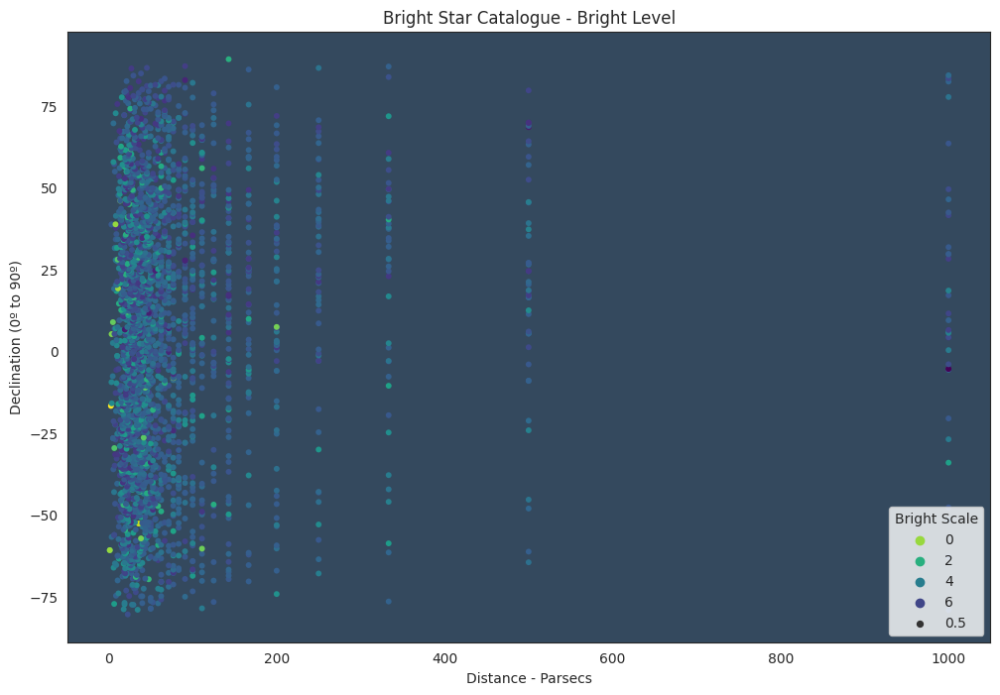

In [23]:
sns.set_style(rc = {"axes.facecolor": "#34495E"})

fig, ax = plt.subplots(figsize=(12, 8))

sns.scatterplot(x="parallax_parsec",
            y="dec",
            hue="vmag",
            size=0.5,
            linewidth=0,
            palette="viridis_r", # Ou "light:seagreen"
            data=milk_distance
            )

ax.legend(title="Bright Scale", facecolor='white', loc="lower right")

ax.set_title("Bright Star Catalogue - Bright Level")
ax.set_xlabel("Distance - Parsecs")
ax.set_ylabel("Declination (0º to 90º)")

Ao olhar o gráfico, fica muito poluído e o fato de plotar variáveis com diferentes medidas, um está em parsecs e outra em graus, traz dificuldade para a interpretação. Vamos transformar a declinação em parsecs para isso acontecer.

In [24]:
degree = list(range(-90, 91, 1))
new_degree = list(range(0, 181, 1))
new_degree = pd.DataFrame({"old": degree, "new": new_degree})

milk_distance["dec_180"] = milk_distance.dec.apply(lambda x: math.trunc(x))

milk_distance = milk_distance.merge(new_degree, how="left", left_on="dec_180", right_on="old")

milk_distance["dec_180"] = milk_distance["new"] + (abs(milk_distance["dec"])%abs(milk_distance["dec_180"]))

milk_distance = milk_distance.drop(columns=["old", "new"])

Agora converta em parsec

In [25]:
milk_distance["dec_parsec"] = (1/(milk_distance["dec_180"]/3600))
milk_distance["ra_parsec"] = (1/(milk_distance["ra"]/3600))

Text(0, 0.5, 'Declination - Parsecs')

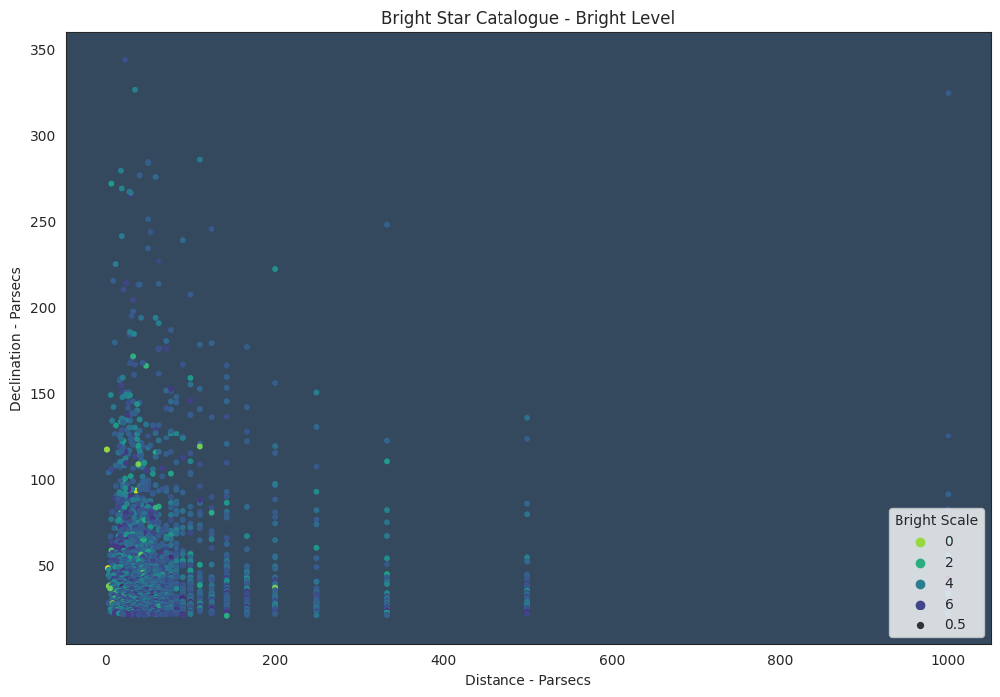

In [26]:
fig, ax = plt.subplots(figsize=(12, 8))

sns.scatterplot(x="parallax_parsec",
            y="dec_parsec",
            hue="vmag",
            size=0.5,
            linewidth=0,
            palette="viridis_r", # Ou "light:seagreen"
            data=milk_distance
            )

ax.legend(title="Bright Scale", facecolor='white', loc="lower right")

ax.set_title("Bright Star Catalogue - Bright Level")
ax.set_xlabel("Distance - Parsecs")
ax.set_ylabel("Declination - Parsecs")

Não muda muito, e pode ter aumentado a imprecisão. 

Vamos ver as estrelas que estão mais pertos da Terra: as que estão a menos de 5 parsecs da Terra. 

In [27]:
milk_distance_close = milk_distance[(milk_distance.parallax_parsec <= 5)].copy()

Text(0, 0.5, 'Declination - Parsecs')

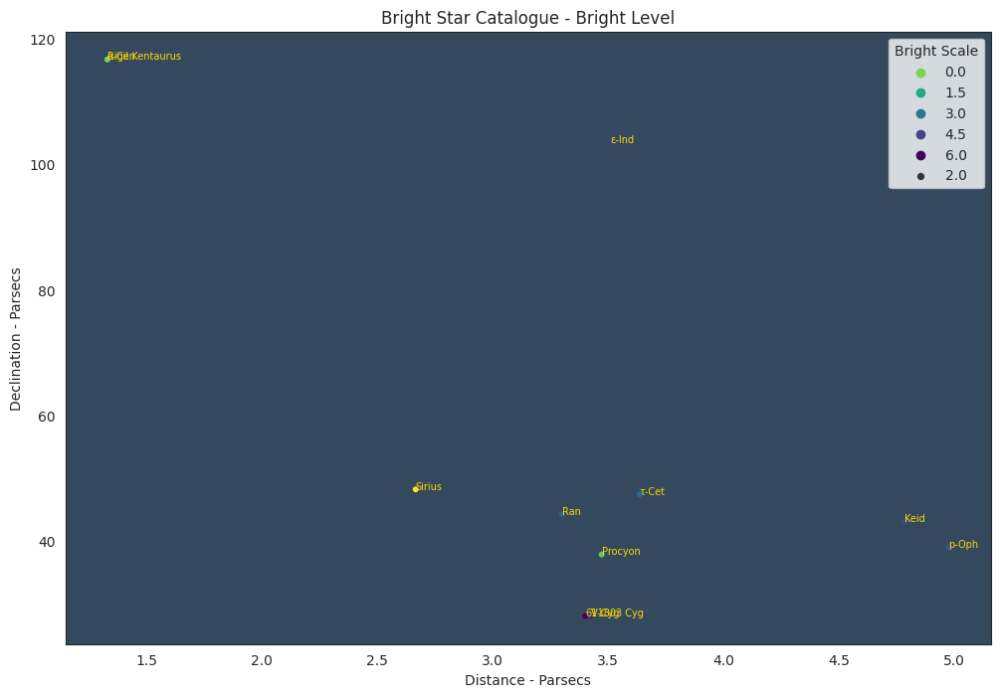

In [28]:
fig, ax = plt.subplots(figsize=(12, 8))

sns.scatterplot(x=milk_distance_close.parallax_parsec,
            y=milk_distance_close.dec_parsec,
            hue=milk_distance_close.vmag,
            size=2.0,
            linewidth=0,
            palette="viridis_r", # Ou "light:seagreen"
            data=milk_distance_close
            )

for x, y, name in zip(milk_distance_close.parallax_parsec, 
                      milk_distance_close.dec_parsec, 
                      milk_distance_close.name_poem):
    
    ax.text(x, y, name, color="gold", fontsize=7)

ax.legend(title="Bright Scale", facecolor='white', loc="upper right")

ax.set_title("Bright Star Catalogue - Bright Level")
ax.set_xlabel("Distance - Parsecs")
ax.set_ylabel("Declination - Parsecs")

Para desencargo de consciência, vamos ver as cores das estrelas

Text(0, 0.5, 'Declination - Parsecs')

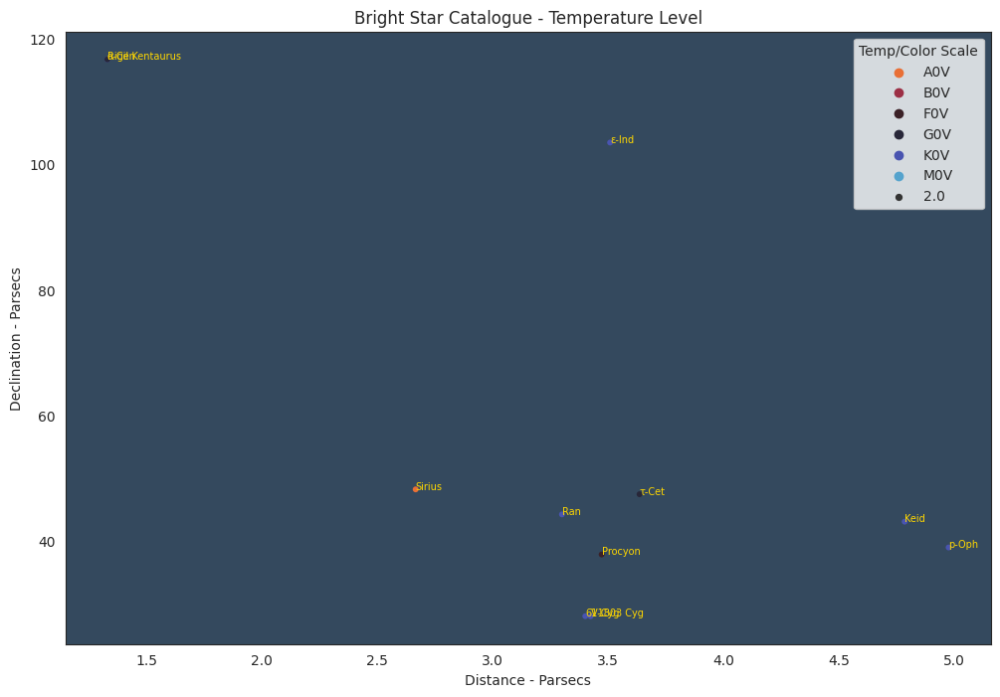

In [29]:
fig, ax = plt.subplots(figsize=(12, 8))

sns.scatterplot(x=milk_distance_close.parallax_parsec,
            y=milk_distance_close.dec_parsec,
            hue=milk_distance_close.color_index,
            hue_order=["A0V", "B0V", "F0V", "G0V", "K0V", "M0V"],
            size=2.0,
            linewidth=0,
            palette="icefire_r", 
            data=milk_distance_close
            )

for y, x, name in zip(milk_distance_close.dec_parsec, 
                      milk_distance_close.parallax_parsec, 
                      milk_distance_close.name_poem):
    
    ax.text(x, y, name, color="gold", fontsize=7)

ax.legend(title="Temp/Color Scale", facecolor='white', loc="upper right")

ax.set_title("Bright Star Catalogue - Temperature Level")
ax.set_xlabel("Distance - Parsecs")
ax.set_ylabel("Declination - Parsecs")

Parece ser a Alfa Centauris que está mais perto da gente - aumente a precisão para ter certeza. E a imagem parece ter sentido ao mostrar a proximidade de Sirius da Terra. 

Text(0, 0.5, 'Declination - Parsecs')

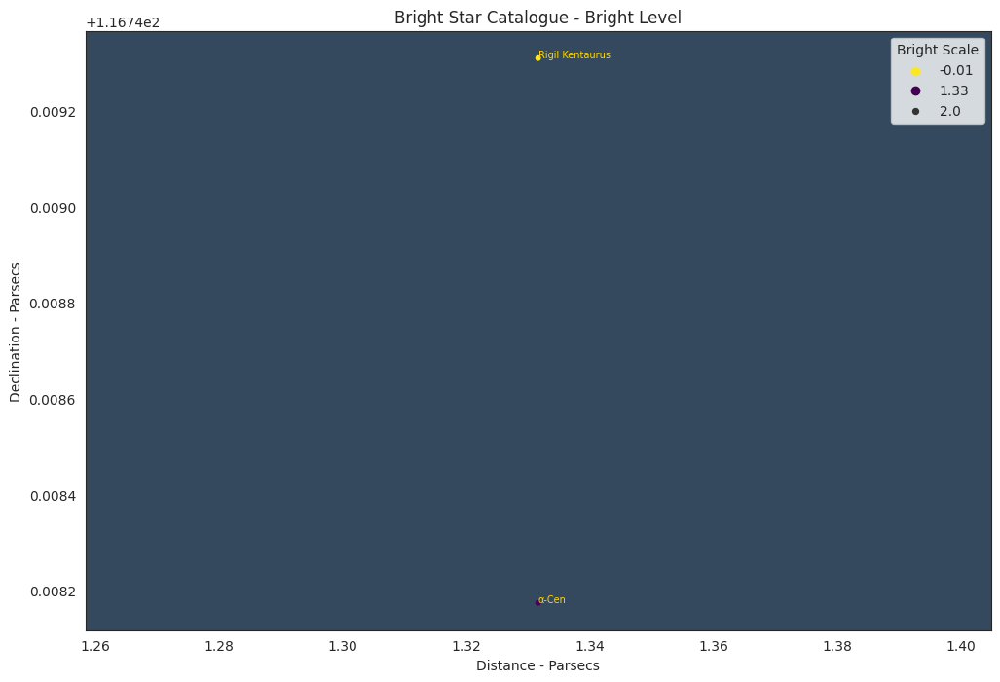

In [30]:
fig, ax = plt.subplots(figsize=(12, 8))

sns.scatterplot(x=milk_distance_close[milk_distance_close.parallax_parsec <= 1.5].parallax_parsec,
            y=milk_distance_close[milk_distance_close.parallax_parsec <= 1.5].dec_parsec,
            hue=milk_distance_close[milk_distance_close.parallax_parsec <= 1.5].vmag,
            size=2.0,
            linewidth=0,
            palette="viridis_r", # Ou "light:seagreen"
            data=milk_distance_close[milk_distance_close.parallax_parsec <= 1.5]
            )

for x, y, name in zip(milk_distance_close[milk_distance_close.parallax_parsec <= 1.5].parallax_parsec, 
                      milk_distance_close[milk_distance_close.parallax_parsec <= 1.5].dec_parsec, 
                      milk_distance_close[milk_distance_close.parallax_parsec <= 1.5].name_poem):
    
    ax.text(x, y, name, color="gold", fontsize=7)

ax.legend(title="Bright Scale", facecolor='white', loc="upper right")

ax.set_title("Bright Star Catalogue - Bright Level")
ax.set_xlabel("Distance - Parsecs")
ax.set_ylabel("Declination - Parsecs")

Além da Alpha Centauris, há a Rigil Centaurus. 

## Faça a visualização 3D do catálogo de estrelas

Use as variáveis, __declination__, __right ascention__ & __parallax__, num único gráfico. Pode deixar o RA e Dec em graus, mas transforme o parallax em parsecs. 

In [31]:
fig = go.Figure(data=[go.Scatter3d(
    x=milk_distance.ra,
    y=milk_distance.dec,
    z=milk_distance.parallax_parsec,
    mode='markers',
    text=(milk_distance.name + " - " + milk_distance.alt_name), 
    name="Bright Level",
    hoverinfo="text", # ou "text + name"
    marker=dict(
        size=2.0,
        color=milk_distance.vmag, # set color to an array/list of desired values
        colorscale='Viridis_r', # choose a colorscale
        opacity=1.0,
        showscale=True
    )
)])

fig.update_layout(width=600, 
                  title_text='Bright Star Catalogue',
                  showlegend=True)

fig.show()

In [32]:
# fig.write_json("bsc_basic.json") #Escreva o arquivo nesse formato para colocar depois no arquivo markdown
fig.write_html("bsc_basic.html", full_html=False, include_plotlyjs='cdn')

Chegue mais perto: até 200 parsecs de distância. 

In [33]:
fig = go.Figure(data=[go.Scatter3d(
    x=milk_distance[milk_distance.parallax_parsec <=200].ra,
    y=milk_distance[milk_distance.parallax_parsec <=200].dec,
    z=milk_distance[milk_distance.parallax_parsec <=200].parallax_parsec,
    mode='markers',
    text=(milk_distance[milk_distance.parallax_parsec <=200].name + " - " + milk_distance[milk_distance.parallax_parsec <=200].alt_name), 
    name="Bright Level",
    hoverinfo="text", # ou "text + name"
    marker=dict(
        size=2.0,
        color=milk_distance[milk_distance.parallax_parsec <=200].vmag, # set color to an array/list of desired values
        colorscale='Viridis_r', # choose a colorscale
        opacity=1.0,
        showscale=True
    )
)])

fig.update_layout(width=600, 
                  title_text='Bright Star Catalogue',
                  showlegend=True)

fig.show()

Veja o catálogo sob a perspectiva das cores das estrelas

In [34]:
fig = go.Figure(data=[go.Scatter3d(
    x=milk_distance.ra,
    y=milk_distance.dec,
    z=milk_distance.parallax_parsec,
    mode='markers',
    text=(milk_distance.name + " - " + milk_distance.name_poem), 
    name="Temperature Level",
    hoverinfo="text",
    marker=dict(
        size=2.0,
        color=milk_distance.bv_color,
        colorscale='Inferno', 
        opacity=1.0,
        showscale=True
    )
)])

fig.update_layout(width=600, 
                  title_text='Bright Star Catalogue',
                  showlegend=True)

fig.show()

Veja as estrelas mais perto da Terra em 3D.

In [35]:
fig = go.Figure(data=[go.Scatter3d(
    x=milk_distance[(milk_distance.parallax_parsec <= 5)].ra,
    y=milk_distance[(milk_distance.parallax_parsec <= 5)].dec,
    z=milk_distance[(milk_distance.parallax_parsec <= 5)].parallax_parsec,
    mode='markers',
    text=(milk_distance[(milk_distance.parallax_parsec <= 5)].name + " - " + milk_distance[(milk_distance.parallax_parsec <= 5)].name_poem), 
    name="      Bright Level",
    hoverinfo="text", # ou "text + name"
    marker=dict(
        size=2.0,
        color=milk_distance[(milk_distance.parallax_parsec <= 5)].vmag, # set color to an array/list of desired values
        colorscale='Viridis_r', # choose a colorscale
        opacity=1.0,
        showscale=True
    )
)])

fig.update_layout(width=600, 
                  title_text='Bright Star Catalogue',
                  showlegend=True)

fig.show()